# Mapping Short-Term Rental Patterns and Housing Pressure Signals in Cape Town

**Notebook 5: Visualizations & Reporting**

**Purpose:**  
This final notebook consolidates the findings from the previous notebooks, presenting comprehensive visualizations and summaries of short-term rental activity and housing pressure across Cape Town. It integrates spatial analysis, the Affordability Pressure Index, and modelling results to provide actionable insights for policymakers, researchers, and urban planners.

**Objectives**
- Present static and interactive visualizations of short-term rental patterns and affordability pressure.
- Highlight wards with the highest pressure and identify underlying drivers.
- Summarize feature importance from modelling to interpret which Airbnb activity metrics contribute most to internal pressure.
- Provide a clear narrative linking spatial patterns, model results, and housing affordability implications.

**Project Goals:**  
- Explore Airbnb listings and availability patterns
- Identify spatial trends in price, density, and activity
- Model a neighborhood-level Affordability Pressure Index
- Visualize key insights through static and interactive maps

## 1. Common notebook setup
### 1.1 Import required libraries

In [3]:
# Import libraries
import sys
sys.path.append("..") # Move up project root to import config
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
from matplotlib.colors import LinearSegmentedColormap
import seaborn as sns
import geopandas as gpd
from sklearn.preprocessing import MinMaxScaler
from sklearn.impute import SimpleImputer
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import r2_score, mean_squared_error

# Enable inline plotting (for Jupyter)
%matplotlib inline

# Import config file
import config

# For interactive maps
import folium
import json
import branca
from folium.plugins import MarkerCluster

### 1.2 Color palette and styling

In [4]:
# Define the color palette
palette = ["#68174c", "#df586a", "#fd9c74", "#fdc48e", "#ffebc8"]

# Set Seaborn styling
sns.set_style("whitegrid")
sns.set_palette(palette)

# Set Matplotlib rcParams for consistent styling
mpl.rcParams['figure.figsize'] = (10, 6)
mpl.rcParams['axes.titlesize'] = 16
mpl.rcParams['axes.labelsize'] = 14
mpl.rcParams['xtick.labelsize'] = 12
mpl.rcParams['ytick.labelsize'] = 12
mpl.rcParams['axes.titleweight'] = 'bold'
mpl.rcParams['axes.labelweight'] = 'bold'
mpl.rcParams['font.family'] = 'DejaVu Serif'

# Create a continuous colormap for visualisations
custom_cmap = LinearSegmentedColormap.from_list("custom_cmap", 
                                                palette).reversed()

### 1.3 Load cleaned datasets

In [5]:
listings_df = pd.read_csv("../data/processed/listings_clean.csv")
calendar_df = pd.read_csv("../data/processed/calendar_clean.csv")
wards_gdf = gpd.read_file("../data/processed/neighbourhoods_clean.geojson")
wards_model = pd.read_csv("../data/processed/wards_affordability_model.csv")
wards_aggregate = pd.read_csv("../data/processed/wards_aggregate.csv")
importance = pd.read_csv("../data/processed/feature_importance.csv")

## 2. Key Summaries & Static Plots
The short-term rental activity and housing pressure across Cape Town’s neighbourhoods is summarised using a series of static visualizations.

The first set of plots highlights the top 20 wards by individual metrics i.e. average price, listing density, turnover (reviews per month), and availability, so as to identify high-activity or high-cost areas.

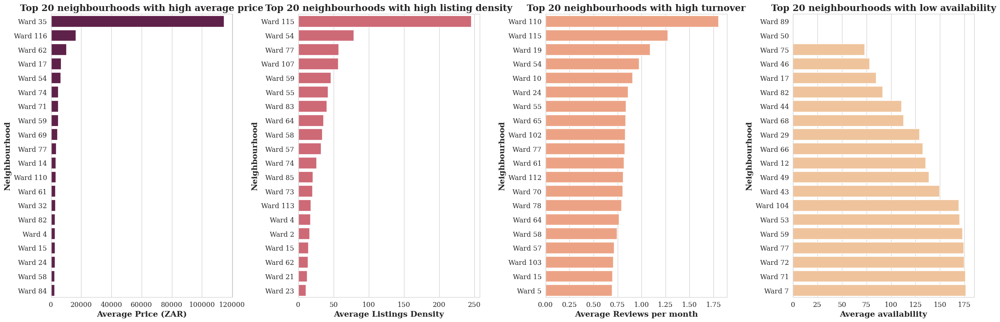

In [6]:
# Top 20 neighbourhoods by average price, listing density and reviews per month
# Subplot layout
fig,axes= plt.subplots(1,4,figsize=(24,8))

# Plot price distribution
sns.barplot(data=wards_aggregate.sort_values('average_price',
                                              ascending=False).head(20),
            x='average_price', y='neighbourhood',ax=axes[0],color=palette[0])
axes[0].set_title("Top 20 neighbourhoods with high average price")
axes[0].set_xlabel("Average Price (ZAR)")
axes[0].set_ylabel("Neighbourhood")

# Plot density distribution
sns.barplot(data=wards_aggregate.sort_values('listing_density',
                                              ascending=False).head(20),
            x='listing_density', y='neighbourhood',ax=axes[1],color=palette[1])
axes[1].set_title("Top 20 neighbourhoods with high listing density")
axes[1].set_xlabel("Average Listings Density")
axes[1].set_ylabel("Neighbourhood")

# Plot reviews distribution
sns.barplot(data=wards_aggregate.sort_values('average_reviews_per_month',
                                              ascending=False).head(20),
x='average_reviews_per_month', y='neighbourhood',ax=axes[2],color=palette[2])
axes[2].set_title("Top 20 neighbourhoods with high turnover")
axes[2].set_xlabel("Average Reviews per month")
axes[2].set_ylabel("Neighbourhood")

# Plot availability distribution
sns.barplot(data=wards_aggregate.sort_values('average_availability',
                                              ascending=True).head(20),
    x='average_availability', y='neighbourhood',ax=axes[3],color=palette[3])
axes[3].set_title("Top 20 neighbourhoods with low availability")
axes[3].set_xlabel("Average availability")
axes[3].set_ylabel("Neighbourhood")

plt.tight_layout()
plt.show()
plt.close()

The second plot focuses on the composite Affordability Pressure Index, showing the top 10 neighbourhoods where short-term rental activity collectively exerts the greatest internal housing pressure. These visual summaries provide a clear, comparative view of both individual metrics and overall pressure, setting the stage for spatial mapping and policy interpretation.

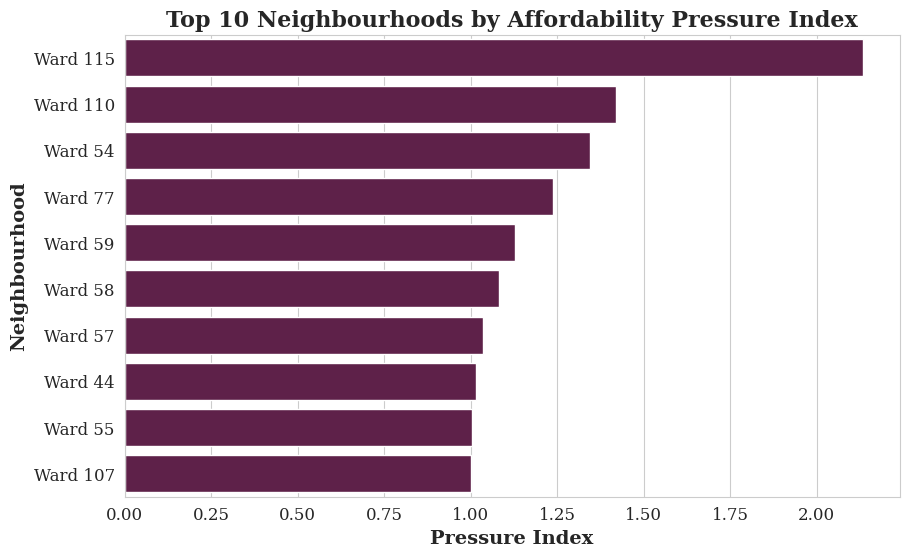

In [7]:
# Top 10 neighborhoods by pressure index
top10_pressure = wards_model.sort_values('pressure_index', 
                                         ascending=False).head(10)

sns.barplot(data=top10_pressure, x='pressure_index', y='neighbourhood',
            color=palette[0])
plt.title("Top 10 Neighbourhoods by Affordability Pressure Index")
plt.xlabel("Pressure Index")
plt.ylabel("Neighbourhood")
plt.show()

## 3. Spatial Visualization
The Affordability Pressure Index across Cape Town’s neighbourhoods is visualised using both static and interactive maps.

- The static choropleth provides a clear, city-wide overview of housing pressure gradients, highlighting wards where short-term rental activity is concentrated.
- The interactive Folium map overlays the same pressure index with individual Airbnb listing locations, allowing exploration of local hotspots and fine-grained spatial patterns.

Together, these maps translate the tabular and aggregated metrics into a spatial perspective, supporting interpretation of neighbourhood-level pressure and informing potential policy interventions.

### 3.1 Static map

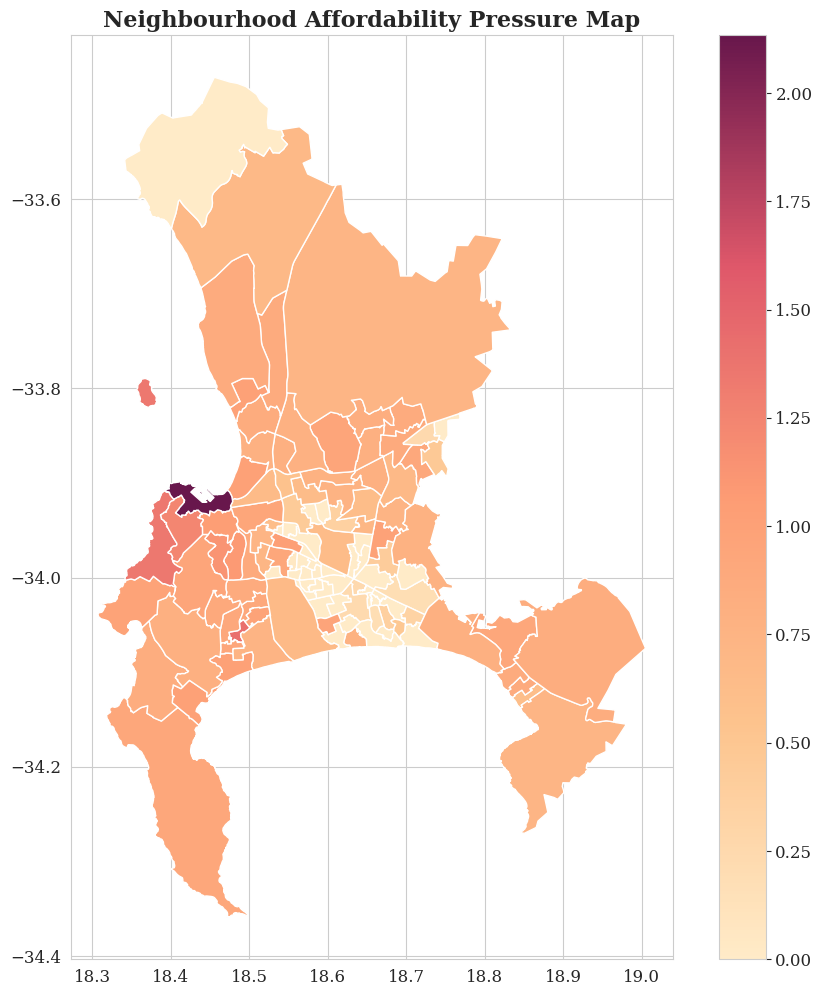

In [8]:
fig, ax = plt.subplots(figsize=(12,12))
wards_model_gdf = wards_gdf.merge(wards_model[['neighbourhood', 
                                               'pressure_index']],
                                               on='neighbourhood', how='left')
# Fill missing pressure_index with 0
wards_model_gdf['pressure_index'] = wards_model_gdf['pressure_index'].fillna(0)

wards_model_gdf.plot(column='pressure_index', cmap=custom_cmap, 
                     legend=True, ax=ax, edgecolor='white')
plt.title("Neighbourhood Affordability Pressure Map")
plt.show()

### 3.2 Interactive map

In [13]:
# Ensure no missing values
wards_model_gdf['pressure_index'] = wards_model_gdf['pressure_index'].fillna(0)

# Create base map
cape_map = folium.Map(location=[-33.9249, 18.4241], zoom_start=11, 
                      tiles="CartoDB positron")

# Create a linear colormap using color palette
linear_colormap = branca.colormap.LinearColormap(
    colors=palette[::-1],  # reverse if you want high pressure darker
    vmin=wards_model_gdf['pressure_index'].min(),
    vmax=wards_model_gdf['pressure_index'].max(),
    caption='Affordability Pressure Index'
)

# Add GeoJson with custom palette
folium.GeoJson(
    wards_model_gdf,
    style_function=lambda feature: {
        'fillColor': linear_colormap(feature['properties']['pressure_index']),
        'color': 'black',
        'weight': 0.3,
        'fillOpacity': 0.7,
    },
    tooltip=folium.GeoJsonTooltip(
        fields=['neighbourhood', 'pressure_index'],
        aliases=['Neighbourhood: ', 'Pressure Index: '],
        localize=True
    )
).add_to(cape_map)

# Add colormap legend
linear_colormap.add_to(cape_map)

# Add clustered Airbnb listings
marker_cluster = MarkerCluster().add_to(cape_map)

for idx, row in listings_df.iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=2,
        color='blue',
        fill=True,
        fill_opacity=0.5
    ).add_to(marker_cluster)

cape_map

## 4. Feature Importance / Drivers of Pressure
The relative contributions of the key activity metrics i.e price, listing density, reviews per month, and availability to the Affordability Pressure Index is visualised. The factors contributing most to internal housing pressure within Cape town wards is analised using both Linear Regression coefficients and Random Forest feature importances. The bar plot allows for direct comparison between the linear and non-linear model perspectives, providing insights into the dominant drivers of short-term rental pressure.

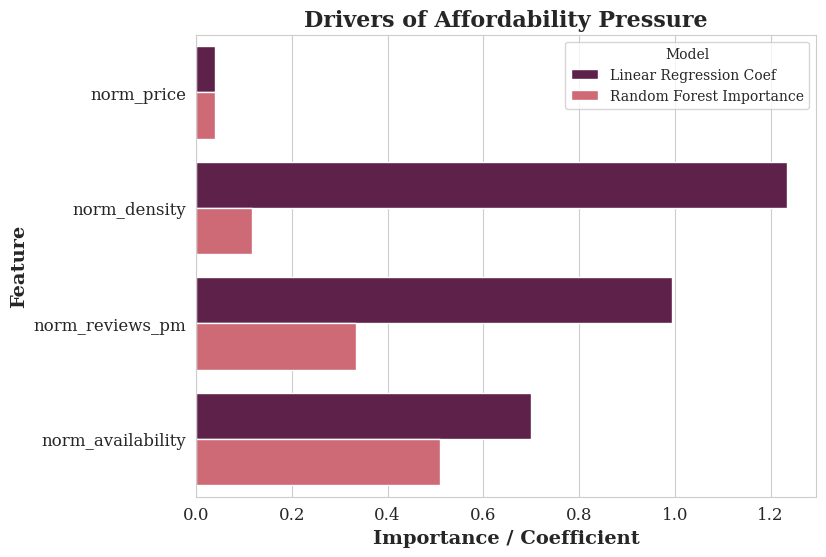

In [10]:
# Melt the DataFrame to display both importances
importance_melted = importance.melt(
    id_vars='Feature',
    value_vars=['Linear Regression Coef', 'Random Forest Importance'],
    var_name='Model',
    value_name='Importance'
)

# Plot
plt.figure(figsize=(8,6))
sns.barplot(data=importance_melted, x='Importance', y='Feature', hue='Model')
plt.title("Drivers of Affordability Pressure")
plt.xlabel("Importance / Coefficient")
plt.ylabel("Feature")
plt.legend(title='Model')
plt.show()

# Key Insights from the project : Mapping Short-Term Rental Patterns and Housing Pressure in Cape Town

**1. Spatial concentration of pressure**
- Short-term rental pressure is not uniform across Cape Town.
- The highest pressure is concentrated in the CBD and waterfront areas (CBD, Waterfront, Foreshore, parts of Woodstock i.e. Ward 115).
- Peripheral and southeastern wards (e.g., Khayelitsha, Blue Downs, Mitchells Plain) experience minimal pressure, indicating an almost radial gradient from the city center.

**2. Affordability Pressure Index (API)**
- Affordability Pressure Index (API) captures multi-dimensional stress.
- Combining price, listing density, reviews per month, and availability provides a robust measure of internal housing pressure.
- API highlights wards where short-term rentals are likely influencing housing affordability, not just high-cost areas.

**3. Drivers of rental affordability pressure**
- Listing density, turnover (reviews per month), and low availability are the primary drivers of API.
- High pricing alone has minimal impact on internal pressure, emphasizing that active short-term rental markets, rather than expensive listings, create housing stress.

**4. Market dynamics**
- Market dynamics differ by neighbourhood type
- Luxury areas with high prices often have fewer listings and moderate activity.
- Mid-range, highly active wards show both high density and turnover, making them hotspots for pressure.

**5. Non-linear interactions** 
- Random Forest models reveal that availability interacts non-linearly with other metrics, indicating complex dynamics in housing pressure that linear models alone may miss.

**6. Policy implications**
- Regulatory attention and targeted interventions should prioritize high-density, high-turnover wards rather than focusing solely on high-price areas.
- Spatially explicit analysis enables identification of neighbourhood-level hotspots for short-term rental impact, supporting precise housing policy planning.

**7. Methodological insight**
- Integrating tabular EDA, spatial analysis, and modelling provides a comprehensive framework for assessing short-term rental pressure.
- The approach is internally consistent: it uses Airbnb-derived metrics to measure relative pressure rather than predicting absolute affordability outcomes.
- This makes the framework flexible, reproducible, and suitable as a foundation for further policy-focused or econometric research.